In [36]:
import plotly.figure_factory as ff
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


pop_data_df = pd.read_csv(r'C:\Users\wenyu\Documents\GitHub\project_1\data\rawdata\census_population_county.csv', encoding = 'ISO-8859-1')

In [37]:
#Convert counties to FIPS
pop_data_df['STATE'] = pop_data_df['STATE'].apply(lambda x: str(x).zfill(2))
pop_data_df['COUNTY'] = pop_data_df['COUNTY'].apply(lambda x: str(x).zfill(3))
pop_data_df['FIPS'] = pop_data_df['STATE'] + pop_data_df['COUNTY']
pop_data_df = pop_data_df[['STNAME','CTYNAME','FIPS','POPESTIMATE2017']]
pop_data_df.head()

,STNAME,CTYNAME,FIPS,POPESTIMATE2017
0,Alabama,Alabama,01000,4875120
1,Alabama,Autauga County,01001,55443
2,Alabama,Baldwin County,01003,212619
3,Alabama,Barbour County,01005,25158
4,Alabama,Bibb County,01007,22555


In [38]:
#Get Crime Data
crime_data = pd.read_csv(r'C:\Users\wenyu\Documents\GitHub\project_1\data\cleandata\fbi_data_p1.csv')
crime_data = crime_data.append(pd.read_csv(r'C:\Users\wenyu\Documents\GitHub\project_1\data\cleandata\fbi_data_p2.csv'))
crime_data = crime_data.append(pd.read_csv(r'C:\Users\wenyu\Documents\GitHub\project_1\data\cleandata\fbi_data_p3.csv'))
crime_data = crime_data.append(pd.read_csv(r'C:\Users\wenyu\Documents\GitHub\project_1\data\cleandata\fbi_data_p4.csv'))
crime_data = crime_data.append(pd.read_csv(r'C:\Users\wenyu\Documents\GitHub\project_1\data\cleandata\fbi_data_p5.csv'))
crime_data = crime_data.append(pd.read_csv(r'C:\Users\wenyu\Documents\GitHub\project_1\data\cleandata\fbi_data_p6.csv'))
crime_data.head()

,Unnamed: 0,ori,year,offense,state,cleared,actual
0,0,HI0010000,1990,aggravated-assault,HI,94,116
1,1,HI0010000,1990,arson,HI,9,37
2,2,HI0010000,1990,burglary,HI,267,1043
3,3,HI0010000,1990,homicide,HI,3,3
4,4,HI0010000,1990,human-trafficing,HI,0,0


In [39]:
#Get Mapping Key
ori_county_fips = pd.read_csv(r'C:\Users\wenyu\Documents\GitHub\project_1\data\cleandata\ori_county_fips_mapping.csv',dtype={'FIPS': str})
ori_county_fips.head()

,ori,state_name,County,FIPS
0,AL0290600,Alabama,AUTAUGA,01001
1,AL0040200,Alabama,AUTAUGA,01001
2,AL0040000,Alabama,AUTAUGA,01001
3,AL0050300,Alabama,BALDWIN,01003
4,AL0050400,Alabama,BALDWIN,01003


In [40]:
#Isolate Crime for 2017 Only
crime_data_2017 = crime_data.loc[crime_data['year']==2017]
crime_data_2017 = crime_data_2017.reset_index(drop=True)
del crime_data_2017['Unnamed: 0']

#Get FIPS in Table
crime_data_2017 = pd.merge(crime_data_2017,ori_county_fips[['ori','FIPS']],how='left',on='ori')
crime_data_2017

,ori,year,offense,state,cleared,actual,FIPS
0,HI0010000,2017,aggravated-assault,HI,171,284,15001
1,HI0010000,2017,arson,HI,9,32,15001
2,HI0010000,2017,burglary,HI,141,872,15001
3,HI0010000,2017,homicide,HI,3,5,15001
4,HI0010000,2017,human-trafficing,HI,0,0,15001
5,HI0010000,2017,larceny,HI,826,3770,15001
6,HI0010000,2017,motor-vehicle-theft,HI,207,731,15001
7,HI0010000,2017,property-crime,HI,1174,5373,15001
8,HI0010000,2017,rape,HI,66,142,15001
9,HI0010000,2017,rape-legacy,HI,0,0,15001


In [41]:
#Crimes to Test = 
try_crimes = ['violent-crime']
crime_data_2017 = crime_data_2017[crime_data_2017['offense'].isin(try_crimes)]

#Group 2017 Data By FIPS
crime_data_2017_FIPS_total_crimes = crime_data_2017.groupby('FIPS')
crime_data_2017_FIPS_total_crimes = pd.DataFrame(crime_data_2017_FIPS_total_crimes['actual'].sum())
crime_data_2017_FIPS_total_crimes.reset_index(inplace=True)
crime_data_2017_FIPS_total_crimes = crime_data_2017_FIPS_total_crimes.rename(columns={'actual': 'Total Crimes'})
crime_data_2017_FIPS_total_crimes

,FIPS,Total Crimes
0,01001,100
1,01003,531
2,01005,113
3,01007,42
4,01009,339
5,01011,48
6,01013,117
7,01015,950
8,01017,175
9,01019,82


In [42]:
#Add Population
crime_data_2017_FIPS_total_crimes = pd.merge(crime_data_2017_FIPS_total_crimes, pop_data_df, on='FIPS',how='left')
crime_data_2017_FIPS_total_crimes = crime_data_2017_FIPS_total_crimes.rename(columns={'STNAME': 'State', 'CTYNAME':'County','POPESTIMATE2017':'Population'})

In [43]:
#Add Crime Rate
crime_data_2017_FIPS_total_crimes['Crime Rate'] = crime_data_2017_FIPS_total_crimes['Total Crimes']*100/crime_data_2017_FIPS_total_crimes['Population']
crime_data_2017_FIPS_total_crimes.head()

,FIPS,Total Crimes,State,County,Population,Crime Rate
0,01001,100,Alabama,Autauga County,55443,0.180365
1,01003,531,Alabama,Baldwin County,212619,0.249742
2,01005,113,Alabama,Barbour County,25158,0.449161
3,01007,42,Alabama,Bibb County,22555,0.186211
4,01009,339,Alabama,Blount County,57827,0.586231


In [44]:
colorscale = ["#f7fbff", "#ebf3fb", "#deebf7", "#d2e3f3", "#c6dbef", "#b3d2e9", "#9ecae1",
    "#85bcdb", "#6baed6", "#57a0ce", "#4292c6", "#3082be", "#2171b5", "#1361a9",
    "#08519c", "#0b4083", "#08306b"]
endpts = list(np.linspace(0, 2, len(colorscale) - 1))
fips = crime_data_2017_FIPS_total_crimes['FIPS'].tolist()
values = crime_data_2017_FIPS_total_crimes['Crime Rate'].tolist()

In [45]:
fig = ff.create_choropleth(
    fips=fips, values=values, scope=['usa'],
    binning_endpoints=endpts, colorscale=colorscale,
    show_state_data=False,
    show_hover=True,
    asp = 2.9,
    title_text = 'Reported Crimes per 100 Population',
    legend_title = 'Reported Crimes per 100 Population'
)
fig.layout.xaxis.fixedrange = False 
fig.layout.yaxis.fixedrange = False 

fig.layout.template = None
fig.show()

In [46]:
# Get Economic Stats
economic_stats = pd.read_csv(r'C:\Users\wenyu\Documents\GitHub\project_1\data\cleandata\counties_economic_stats.csv', encoding = 'ISO-8859-1', dtype={'FIPS Code': str})
economic_stats = economic_stats.rename(columns={'FIPS Code': 'FIPS'})
economic_stats = economic_stats[['FIPS','Less Than High School %','High School %','Some College %','College or Higher %','Unemployment Rate','Median Income']]
economic_stats.head()

,FIPS,Less Than High School %,High School %,Some College %,College or Higher %,Unemployment Rate,Median Income
0,00000,12.7,27.3,29.1,30.9,NaN,NaN
1,01000,14.7,30.9,29.9,24.5,NaN,NaN
2,01001,12.3,33.6,29.1,25.0,3.9,58343.0
3,01003,9.8,27.8,31.7,30.7,4.1,56607.0
4,01005,26.9,35.5,25.5,12.0,5.8,32490.0


In [47]:
# Merge Crime With Economic Stats
crime_data_2017_FIPS_total_crimes = pd.merge(crime_data_2017_FIPS_total_crimes, economic_stats, on = 'FIPS', how = 'left')
crime_data_2017_FIPS_total_crimes.head()

,FIPS,Total Crimes,State,County,Population,Crime Rate,Less Than High School %,High School %,Some College %,College or Higher %,Unemployment Rate,Median Income
0,01001,100,Alabama,Autauga County,55443,0.180365,12.3,33.6,29.1,25.0,3.9,58343.0
1,01003,531,Alabama,Baldwin County,212619,0.249742,9.8,27.8,31.7,30.7,4.1,56607.0
2,01005,113,Alabama,Barbour County,25158,0.449161,26.9,35.5,25.5,12.0,5.8,32490.0
3,01007,42,Alabama,Bibb County,22555,0.186211,17.9,43.9,25.0,13.2,4.4,45795.0
4,01009,339,Alabama,Blount County,57827,0.586231,20.2,32.3,34.4,13.1,4.0,48253.0


In [48]:
colorscale = ["#f7fbff", "#ebf3fb", "#deebf7", "#d2e3f3", "#c6dbef", "#b3d2e9", "#9ecae1",
    "#85bcdb", "#6baed6", "#57a0ce", "#4292c6", "#3082be", "#2171b5", "#1361a9",
    "#08519c", "#0b4083", "#08306b"]
endpts = list(np.linspace(1, 12, len(colorscale) - 1))
fips = crime_data_2017_FIPS_total_crimes['FIPS'].tolist()
values = crime_data_2017_FIPS_total_crimes['Unemployment Rate'].tolist()
fig = ff.create_choropleth(
    fips=fips, values=values, scope=['usa'],
    binning_endpoints=endpts, colorscale=colorscale,
    show_state_data=False,
    show_hover=True,
    asp = 2.9,
    title_text = 'Unemployment Rate',
    legend_title = 'Unemployment Rate'
)
fig.layout.xaxis.fixedrange = False 
fig.layout.yaxis.fixedrange = False 

fig.layout.template = None
fig.show()

In [49]:
colorscale = ["#f7fbff", "#ebf3fb", "#deebf7", "#d2e3f3", "#c6dbef", "#b3d2e9", "#9ecae1",
    "#85bcdb", "#6baed6", "#57a0ce", "#4292c6", "#3082be", "#2171b5", "#1361a9",
    "#08519c", "#0b4083", "#08306b"]
endpts = list(np.linspace(1, 25, len(colorscale) - 1))
fips = crime_data_2017_FIPS_total_crimes['FIPS'].tolist()
values = crime_data_2017_FIPS_total_crimes['Less Than High School %'].tolist()
fig = ff.create_choropleth(
    fips=fips, values=values, scope=['usa'],
    binning_endpoints=endpts, colorscale=colorscale,
    show_state_data=False,
    show_hover=True,
    asp = 2.9,
    title_text = 'Less Than High School %',
    legend_title = 'Less Than High School %'
)
fig.layout.xaxis.fixedrange = False 
fig.layout.yaxis.fixedrange = False 

fig.layout.template = None
fig.show()

In [50]:
colorscale = ["#f7fbff", "#ebf3fb", "#deebf7", "#d2e3f3", "#c6dbef", "#b3d2e9", "#9ecae1",
    "#85bcdb", "#6baed6", "#57a0ce", "#4292c6", "#3082be", "#2171b5", "#1361a9",
    "#08519c", "#0b4083", "#08306b"]
colorscale.reverse()
endpts = list(np.linspace(1, 75000, len(colorscale) - 1))
fips = crime_data_2017_FIPS_total_crimes['FIPS'].tolist()
values = crime_data_2017_FIPS_total_crimes['Median Income'].tolist()
fig = ff.create_choropleth(
    fips=fips, values=values, scope=['usa'],
    binning_endpoints=endpts, colorscale=colorscale,
    show_state_data=False,
    show_hover=True,
    asp = 2.9,
    title_text = 'Median Income',
    legend_title = 'Median Income'
)
fig.layout.xaxis.fixedrange = False 
fig.layout.yaxis.fixedrange = False 

fig.layout.template = None
fig.show()

In [51]:
crime_data_2017_FIPS_total_crimes.head()

,FIPS,Total Crimes,State,County,Population,Crime Rate,Less Than High School %,High School %,Some College %,College or Higher %,Unemployment Rate,Median Income
0,01001,100,Alabama,Autauga County,55443,0.180365,12.3,33.6,29.1,25.0,3.9,58343.0
1,01003,531,Alabama,Baldwin County,212619,0.249742,9.8,27.8,31.7,30.7,4.1,56607.0
2,01005,113,Alabama,Barbour County,25158,0.449161,26.9,35.5,25.5,12.0,5.8,32490.0
3,01007,42,Alabama,Bibb County,22555,0.186211,17.9,43.9,25.0,13.2,4.4,45795.0
4,01009,339,Alabama,Blount County,57827,0.586231,20.2,32.3,34.4,13.1,4.0,48253.0


In [52]:
# Plot Crimes vs Income
crimes_vs_income = crime_data_2017_FIPS_total_crimes[['FIPS', 'Crime Rate', 'Median Income','Population']]
crimes_vs_income = crimes_vs_income.dropna()
crimes_vs_income.head()

,FIPS,Crime Rate,Median Income,Population
0,01001,0.180365,58343.0,55443
1,01003,0.249742,56607.0,212619
2,01005,0.449161,32490.0,25158
3,01007,0.186211,45795.0,22555
4,01009,0.586231,48253.0,57827


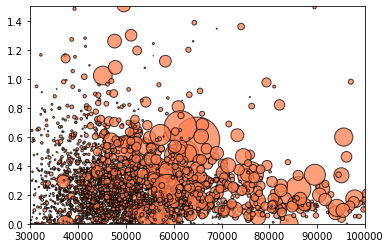

In [53]:
income = crimes_vs_income['Median Income'].values
crime_rate = crimes_vs_income['Crime Rate'].values
population = crimes_vs_income['Population'].values
inc_vs_crime = plt.scatter(income,crime_rate,marker = 'o',c = 'coral',edgecolor= 'black',s = population/5000, alpha = 0.75,label = 'Rural')
plt.xlim(30000, 100000)
plt.ylim(0, 1.5)
plt.plot()

# Show plot
plt.show()

In [54]:
# Plot Crimes vs Income
crimes_vs_unemploy = crime_data_2017_FIPS_total_crimes[['FIPS', 'Crime Rate', 'Unemployment Rate','Population']]
crimes_vs_unemploy = crimes_vs_unemploy.dropna()
crimes_vs_unemploy.head()

,FIPS,Crime Rate,Unemployment Rate,Population
0,01001,0.180365,3.9,55443
1,01003,0.249742,4.1,212619
2,01005,0.449161,5.8,25158
3,01007,0.186211,4.4,22555
4,01009,0.586231,4.0,57827


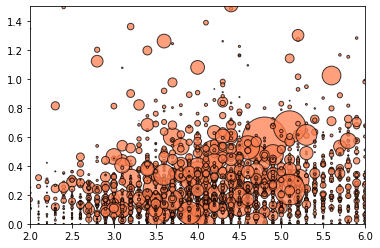

In [55]:
unemploy = crimes_vs_unemploy['Unemployment Rate'].values
crime_rate = crimes_vs_unemploy['Crime Rate'].values
population = crimes_vs_unemploy['Population'].values
inc_vs_crime = plt.scatter(unemploy,crime_rate,marker = 'o',c = 'coral',edgecolor= 'black',s = population/5000, alpha = 0.75,label = 'Rural')
plt.xlim(2, 6)
plt.ylim(0, 1.5)
plt.plot()

# Show plot
plt.show()

In [56]:
# Plot Crimes vs Education
crimes_vs_education = crime_data_2017_FIPS_total_crimes[['FIPS', 'Crime Rate', 'Less Than High School %','Population']]
crimes_vs_education = crimes_vs_education.dropna()
crimes_vs_education.head()

,FIPS,Crime Rate,Less Than High School %,Population
0,01001,0.180365,12.3,55443
1,01003,0.249742,9.8,212619
2,01005,0.449161,26.9,25158
3,01007,0.186211,17.9,22555
4,01009,0.586231,20.2,57827


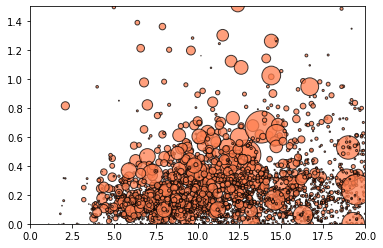

In [57]:
education = crimes_vs_education['Less Than High School %'].values
crime_rate = crimes_vs_education['Crime Rate'].values
population = crimes_vs_education['Population'].values
inc_vs_crime = plt.scatter(education,crime_rate,marker = 'o',c = 'coral',edgecolor= 'black',s = population/5000, alpha = 0.75,label = 'Rural')
plt.xlim(0, 20)
plt.ylim(0, 1.5)
plt.plot()

# Show plot
plt.show()

In [58]:
# Get Pop Density
pop_density = pd.read_csv(r'C:\Users\wenyu\Documents\GitHub\project_1\data\cleandata\pop_density.csv', encoding = 'ISO-8859-1', dtype={'FIPS': str})
pop_density.head()

,FIPS,Pop Per Sq Mile
0,01001,91.8
1,01003,114.6
2,01005,31.0
3,01007,36.8
4,01009,88.9


In [59]:
# Merge Crime With Pop Density
crime_data_2017_FIPS_total_crimes = pd.merge(crime_data_2017_FIPS_total_crimes, pop_density, on = 'FIPS', how = 'left')
crime_data_2017_FIPS_total_crimes

,FIPS,Total Crimes,State,County,Population,Crime Rate,Less Than High School %,High School %,Some College %,College or Higher %,Unemployment Rate,Median Income,Pop Per Sq Mile
0,01001,100,Alabama,Autauga County,55443,0.180365,12.3,33.6,29.1,25.0,3.9,58343.0,91.8
1,01003,531,Alabama,Baldwin County,212619,0.249742,9.8,27.8,31.7,30.7,4.1,56607.0,114.6
2,01005,113,Alabama,Barbour County,25158,0.449161,26.9,35.5,25.5,12.0,5.8,32490.0,31.0
3,01007,42,Alabama,Bibb County,22555,0.186211,17.9,43.9,25.0,13.2,4.4,45795.0,36.8
4,01009,339,Alabama,Blount County,57827,0.586231,20.2,32.3,34.4,13.1,4.0,48253.0,88.9
5,01011,48,Alabama,Bullock County,10176,0.471698,28.6,36.6,21.4,13.4,4.9,29113.0,17.5
6,01013,117,Alabama,Butler County,19898,0.587999,18.9,40.4,24.5,16.1,5.5,36842.0,27.0
7,01015,950,Alabama,Calhoun County,114664,0.828508,16.8,32.2,33.1,17.9,5.0,45937.0,195.7
8,01017,175,Alabama,Chambers County,33758,0.518396,19.1,38.4,29.1,13.3,4.1,36883.0,57.4
9,01019,82,Alabama,Cherokee County,25815,0.317645,20.5,38.2,28.9,12.5,4.1,44842.0,46.9


In [60]:
# Divide into Rural and Urban
urban_data = crime_data_2017_FIPS_total_crimes[crime_data_2017_FIPS_total_crimes['Pop Per Sq Mile'] > 500]
rural_data = crime_data_2017_FIPS_total_crimes[crime_data_2017_FIPS_total_crimes['Pop Per Sq Mile'] <= 500]

In [61]:
# Plot Crimes vs Income
crimes_vs_income_urban = urban_data[['FIPS', 'Crime Rate', 'Median Income','Population']]
crimes_vs_income_rural = rural_data[['FIPS', 'Crime Rate', 'Median Income','Population']]
crimes_vs_income_urban = crimes_vs_income_urban.dropna()
crimes_vs_income_rural = crimes_vs_income_rural.dropna()

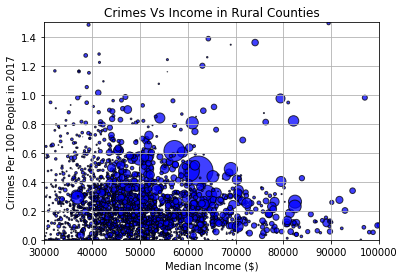

In [76]:
income = crimes_vs_income_urban['Median Income'].values
crime_rate = crimes_vs_income_urban['Crime Rate'].values
population = crimes_vs_income_urban['Population'].values
#inc_vs_crime_urban = plt.scatter(income,crime_rate,marker = 'o',c = 'red',edgecolor= 'black',s = population/5000, alpha = 0.75,label = 'Urban')

income = crimes_vs_income_rural['Median Income'].values
crime_rate = crimes_vs_income_rural['Crime Rate'].values
population = crimes_vs_income_rural['Population'].values
inc_vs_crime_rural = plt.scatter(income,crime_rate,marker = 'o',c = 'blue',edgecolor= 'black',s = population/5000, alpha = 0.75,label = 'Rural')

plt.xlim(30000, 100000)
plt.ylim(0, 1.5)
plt.grid()
plt.plot()
plt.title('Crimes Vs Income in Rural Counties')
plt.xlabel('Median Income ($)')
plt.ylabel('Crimes Per 100 People in 2017')

# Show plot
plt.show()

In [63]:
# Plot Crimes vs Unemployment
crimes_vs_unemploy_urban = urban_data[['FIPS', 'Crime Rate', 'Unemployment Rate','Population']]
crimes_vs_unemploy_urban = crimes_vs_unemploy_urban.dropna()
crimes_vs_unemploy_rural = rural_data[['FIPS', 'Crime Rate', 'Unemployment Rate','Population']]
crimes_vs_unemploy_rural = crimes_vs_unemploy_rural.dropna()

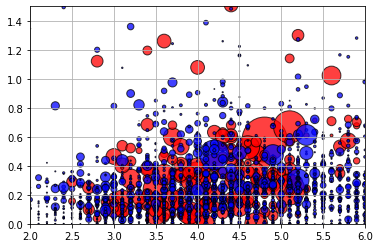

In [64]:
unemploy = crimes_vs_unemploy_urban['Unemployment Rate'].values
crime_rate = crimes_vs_unemploy_urban['Crime Rate'].values
population = crimes_vs_unemploy_urban['Population'].values
unemploy_vs_crime = plt.scatter(unemploy,crime_rate,marker = 'o',c = 'red',edgecolor= 'black',s = population/5000, alpha = 0.75,label = 'Rural')

unemploy = crimes_vs_unemploy_rural['Unemployment Rate'].values
crime_rate = crimes_vs_unemploy_rural['Crime Rate'].values
population = crimes_vs_unemploy_rural['Population'].values
unemploy_vs_crime = plt.scatter(unemploy,crime_rate,marker = 'o',c = 'blue',edgecolor= 'black',s = population/5000, alpha = 0.75,label = 'Rural')

plt.xlim(2, 6)
plt.ylim(0, 1.5)
plt.grid()
plt.plot()

# Show plot
plt.show()

In [65]:
# Plot Crimes vs Education
crimes_vs_education_urban = urban_data[['FIPS', 'Crime Rate', 'Less Than High School %','Population']]
crimes_vs_education_urban = crimes_vs_education_urban.dropna()
crimes_vs_education_rural = rural_data[['FIPS', 'Crime Rate', 'Less Than High School %','Population']]
crimes_vs_education_rural = crimes_vs_education_rural.dropna()

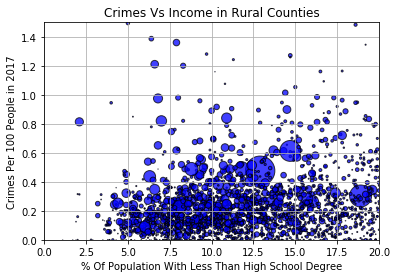

In [78]:
education = crimes_vs_education_urban['Less Than High School %'].values
crime_rate = crimes_vs_education_urban['Crime Rate'].values
population = crimes_vs_education_urban['Population'].values
#edu_vs_crime = plt.scatter(education,crime_rate,marker = 'o',c = 'red',edgecolor= 'black',s = population/5000, alpha = 0.75,label = 'Rural')

education = crimes_vs_education_rural['Less Than High School %'].values
crime_rate = crimes_vs_education_rural['Crime Rate'].values
population = crimes_vs_education_rural['Population'].values
edu_vs_crime = plt.scatter(education,crime_rate,marker = 'o',c = 'blue',edgecolor= 'black',s = population/5000, alpha = 0.75,label = 'Rural')

plt.xlim(0, 20)
plt.ylim(0, 1.5)
plt.grid()
plt.plot()

plt.title('Crimes Vs Income in Rural Counties')
plt.xlabel('% Of Population With Less Than High School Degree')
plt.ylabel('Crimes Per 100 People in 2017')

# Show plot
plt.show()

In [67]:
# Filter For 

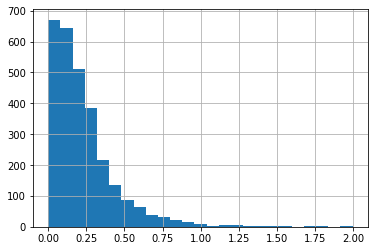

In [68]:
crime_data_2017_FIPS_total_crimes_no_outlier = crime_data_2017_FIPS_total_crimes[crime_data_2017_FIPS_total_crimes['Crime Rate']<2]

crime_data_2017_FIPS_total_crimes_no_outlier_rural = crime_data_2017_FIPS_total_crimes_no_outlier[crime_data_2017_FIPS_total_crimes_no_outlier['Pop Per Sq Mile'] <= 500]
crime_data_2017_FIPS_total_crimes_no_outlier_rural['Crime Rate'].hist(bins=25)

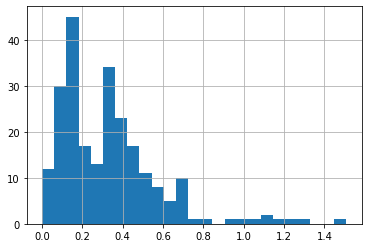

In [69]:
crime_data_2017_FIPS_total_crimes_no_outlier_urban = crime_data_2017_FIPS_total_crimes_no_outlier[crime_data_2017_FIPS_total_crimes_no_outlier['Pop Per Sq Mile'] > 500]
crime_data_2017_FIPS_total_crimes_no_outlier_urban['Crime Rate'].hist(bins=25)